In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import torch
import torch.nn as nn
import torch.optim as optim
from torch.autograd import Variable
import torch.utils.data as data
import random, time
from torchvision import transforms
from PIL import Image
import os , itertools, warnings
import matplotlib.pyplot as plt
import sys

warnings.filterwarnings("ignore")
PATH = "/kaggle/input/cycle-gans"
sys.path.insert(1, PATH)

In [2]:
from CycleGANs import *
data_dir = "/kaggle/input/daynight-cityview"
params = {
    'batch_size':1,
    'input_size':256,
    'resize_scale':286,
    'crop_size':256,
    'fliplr':True,
    'num_epochs': 20,
    'decay_epoch':250,
    'ngf':32,   #number of generator filters
    'ndf':64,   #number of discriminator filters
    'num_resnet':6, #number of resnet blocks
    'lrG':0.0002,    #learning rate for generator
    'lrD':0.0002,    #learning rate for discriminator
    'beta1':0.5 ,    #beta1 for Adam optimizer
    'beta2':0.999 ,  #beta2 for Adam optimizer
    'lambdaA':10 ,   #lambdaA for cycle loss
    'lambdaB':10  ,  #lambdaB for cycle loss
}

In [3]:
transform = transforms.Compose([
    transforms.Resize(size=params['input_size']),
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
])
train_data_A = DatasetFromFolder(data_dir, subfolder='day', 
                                 transform=transform,
                                 resize_scale=params['resize_scale'], 
                                 crop_size=params['crop_size'], 
                                 fliplr=params['fliplr'])
train_data_loader_A = torch.utils.data.DataLoader(dataset=train_data_A, 
                                                  batch_size=params['batch_size'], 
                                                  shuffle=True)
train_data_B = DatasetFromFolder(data_dir, subfolder='night', 
                                 transform=transform,
                                 resize_scale=params['resize_scale'], 
                                 crop_size=params['crop_size'], 
                                 fliplr=params['fliplr'])
train_data_loader_B = torch.utils.data.DataLoader(dataset=train_data_B, 
                                                  batch_size=params['batch_size'], 
                                                  shuffle=True)
#Load test data
test_data_A = DatasetFromFolder(data_dir, 
                                subfolder='day', transform=transform)
test_data_loader_A = torch.utils.data.DataLoader(dataset=test_data_A, 
                                                 batch_size=params['batch_size'], 
                                                 shuffle=False)
test_data_B = DatasetFromFolder(data_dir, 
                                subfolder='night', transform=transform)
test_data_loader_B = torch.utils.data.DataLoader(dataset=test_data_B, 
                                                 batch_size=params['batch_size'], 
                                                 shuffle=False)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [4]:
len(train_data_loader_A), len(train_data_loader_B), len(test_data_loader_A), len(test_data_loader_B)

(522, 227, 522, 227)

In [5]:
# Get specific test images
test_real_A_data = train_data_A.__getitem__(11).unsqueeze(0) # Convert to 4d tensor (BxNxHxW)
test_real_B_data = train_data_B.__getitem__(91).unsqueeze(0)
#print(test_real_A_data)
#Build Model 
G_A = Generator(3, params['ngf'], 3, params['num_resnet']).cuda() # input_dim, num_filter, output_dim, num_resnet
G_B = Generator(3, params['ngf'], 3, params['num_resnet']).cuda()

D_A = Discriminator(3, params['ndf'], 1).cuda() # input_dim, num_filter, output_dim
D_B = Discriminator(3, params['ndf'], 1).cuda()

G_A.normal_weight_init(mean=0.0, std=0.02)
G_B.normal_weight_init(mean=0.0, std=0.02)
D_A.normal_weight_init(mean=0.0, std=0.02)
D_B.normal_weight_init(mean=0.0, std=0.02)


G_optimizer = torch.optim.Adam(itertools.chain(G_A.parameters(), 
                                               G_B.parameters()), 
                               lr=params['lrG'], 
                               betas=(params['beta1'], params['beta2'])
                              )
D_A_optimizer = torch.optim.Adam(D_A.parameters(), lr=params['lrD'], 
                                 betas=(params['beta1'], params['beta2']))
D_B_optimizer = torch.optim.Adam(D_B.parameters(), lr=params['lrD'], 
                                 betas=(params['beta1'], params['beta2']))

MSE_Loss = torch.nn.MSELoss().cuda()
L1_Loss = torch.nn.L1Loss().cuda()
# # Training GAN
D_A_avg_losses = []
D_B_avg_losses = []
G_A_avg_losses = []
G_B_avg_losses = []
cycle_A_avg_losses = []
cycle_B_avg_losses = []

Epoch [1/20] (in 0362 seconds), Step [0200/0522], D_A_loss: 0.1278, D_B_loss: 0.1869, G_A_loss: 0.5614, G_B_loss: 0.3460


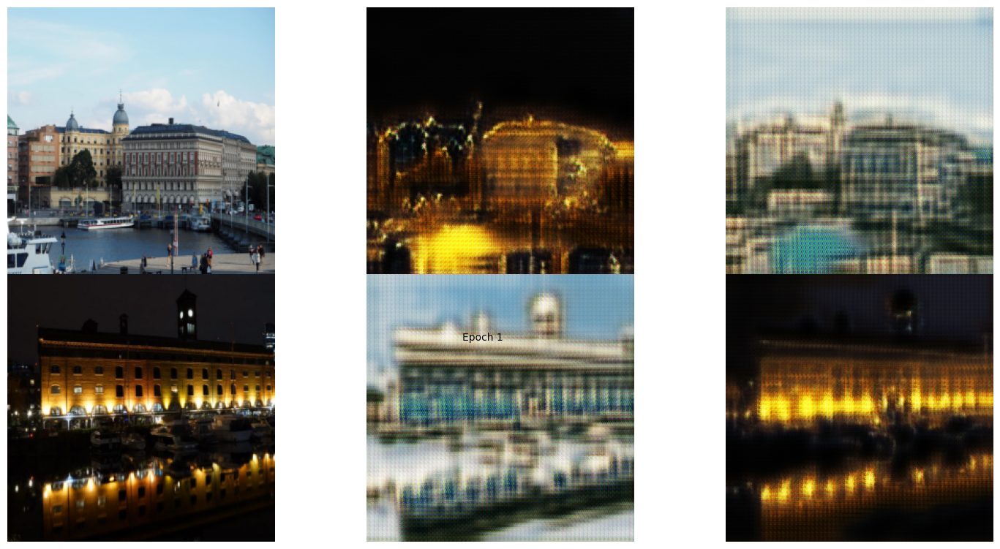

Epoch [2/20] (in 0361 seconds), Step [0200/0522], D_A_loss: 0.1743, D_B_loss: 0.0851, G_A_loss: 1.1116, G_B_loss: 0.2856


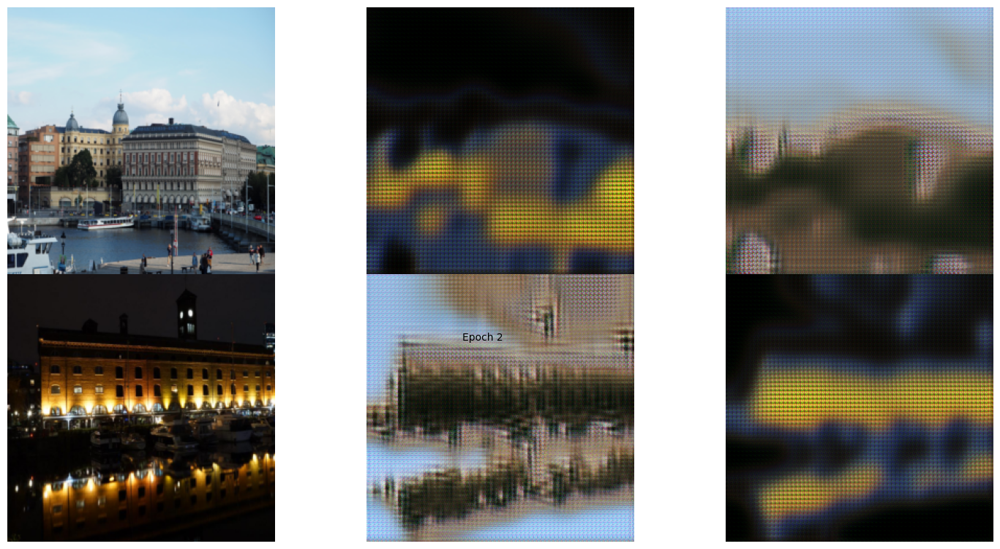

Epoch [3/20] (in 0363 seconds), Step [0200/0522], D_A_loss: 0.0735, D_B_loss: 0.0341, G_A_loss: 0.2919, G_B_loss: 0.1174


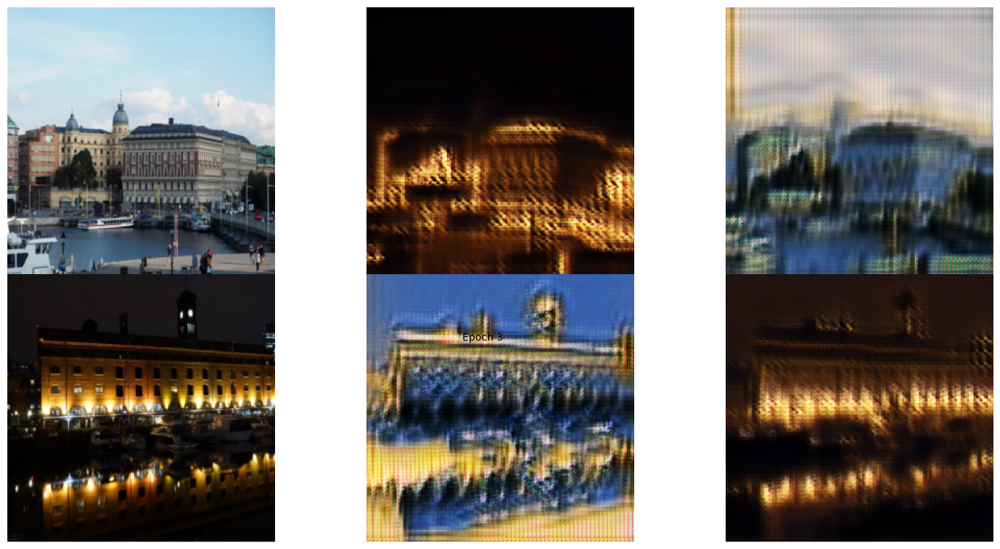

Epoch [4/20] (in 0364 seconds), Step [0200/0522], D_A_loss: 0.1795, D_B_loss: 0.1727, G_A_loss: 0.3568, G_B_loss: 0.2576


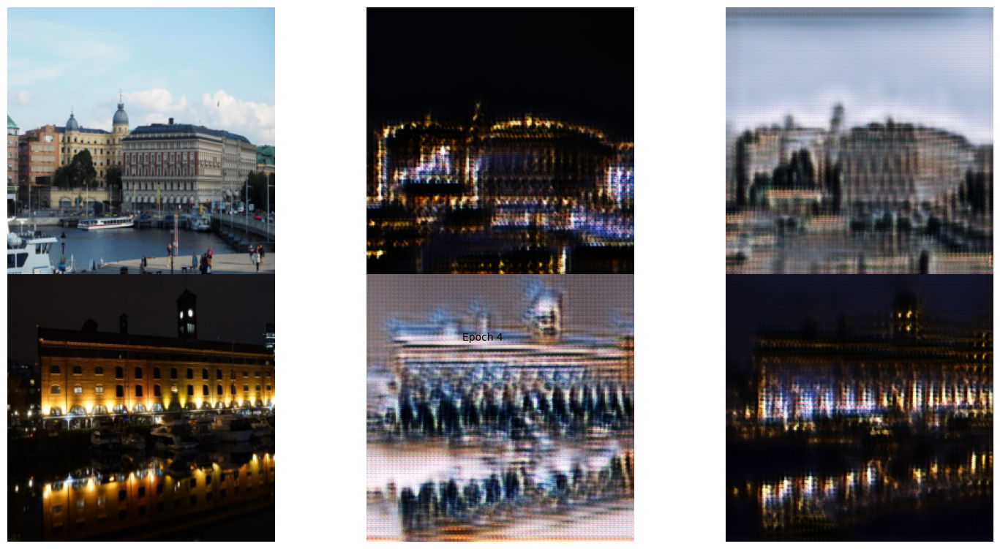

Epoch [5/20] (in 0363 seconds), Step [0200/0522], D_A_loss: 0.0841, D_B_loss: 0.1394, G_A_loss: 0.4638, G_B_loss: 0.6788


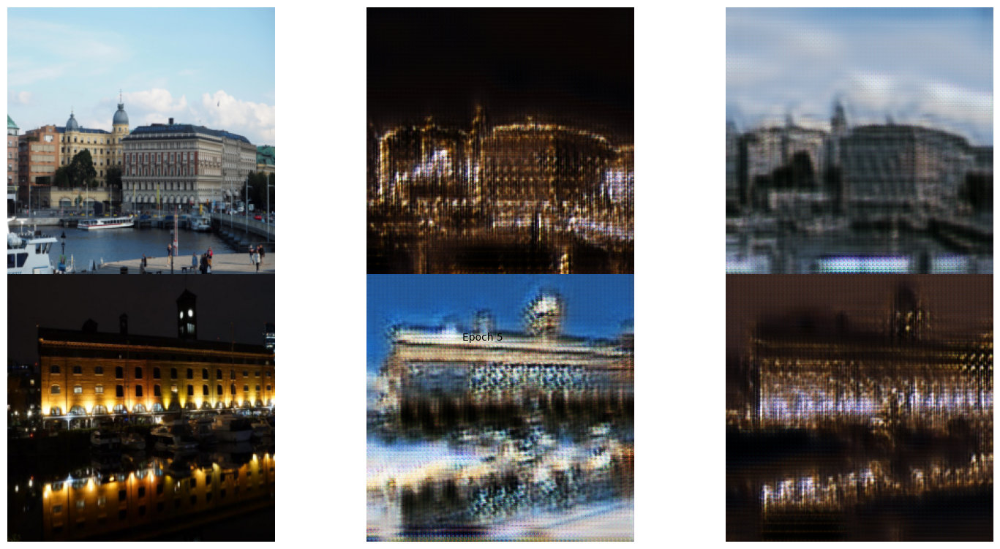

Epoch [6/20] (in 0362 seconds), Step [0200/0522], D_A_loss: 0.1362, D_B_loss: 0.2957, G_A_loss: 0.0740, G_B_loss: 0.5135


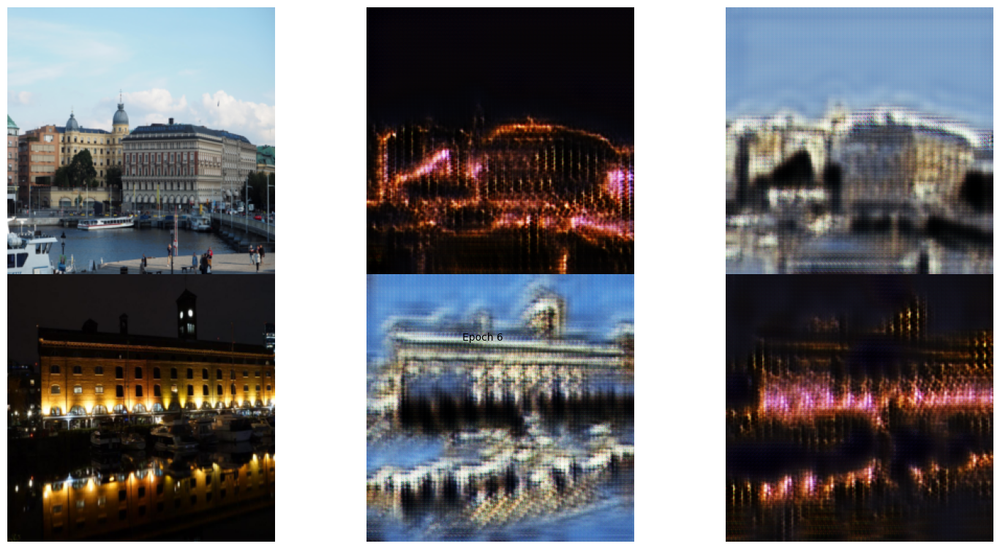

Epoch [7/20] (in 0360 seconds), Step [0200/0522], D_A_loss: 0.1852, D_B_loss: 0.0810, G_A_loss: 0.3110, G_B_loss: 0.3810


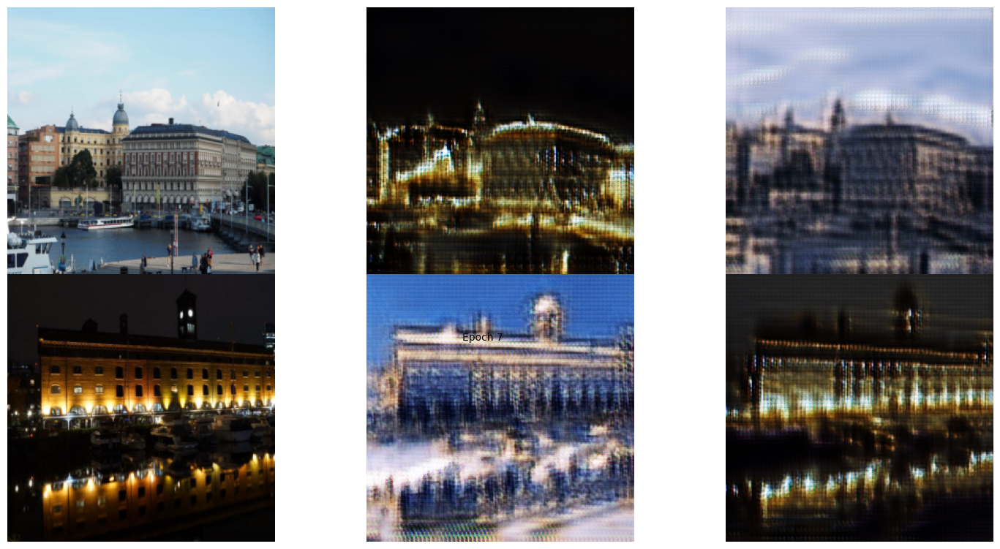

Epoch [8/20] (in 0362 seconds), Step [0200/0522], D_A_loss: 0.2979, D_B_loss: 0.0444, G_A_loss: 0.3130, G_B_loss: 0.0674


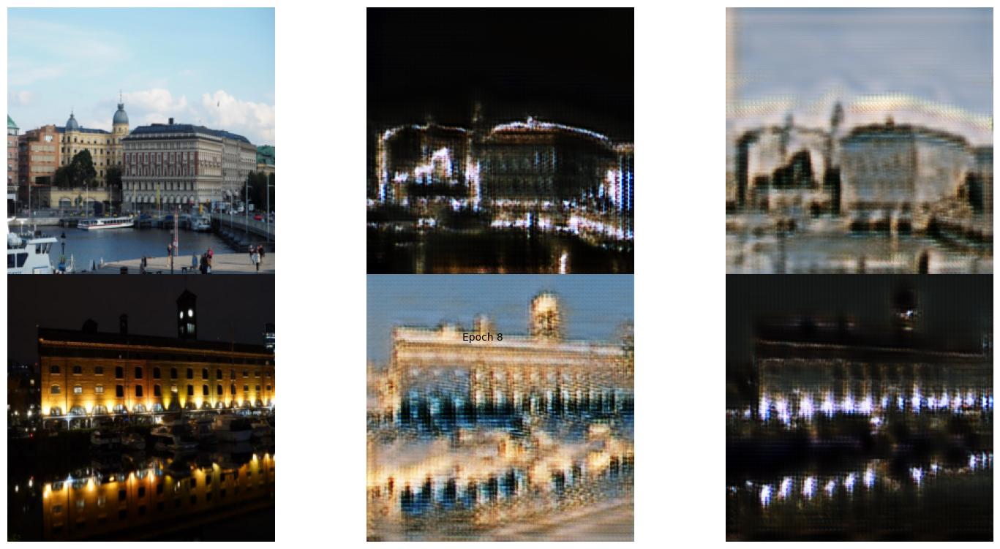

Epoch [9/20] (in 0359 seconds), Step [0200/0522], D_A_loss: 0.1154, D_B_loss: 0.2856, G_A_loss: 0.8024, G_B_loss: 0.1939


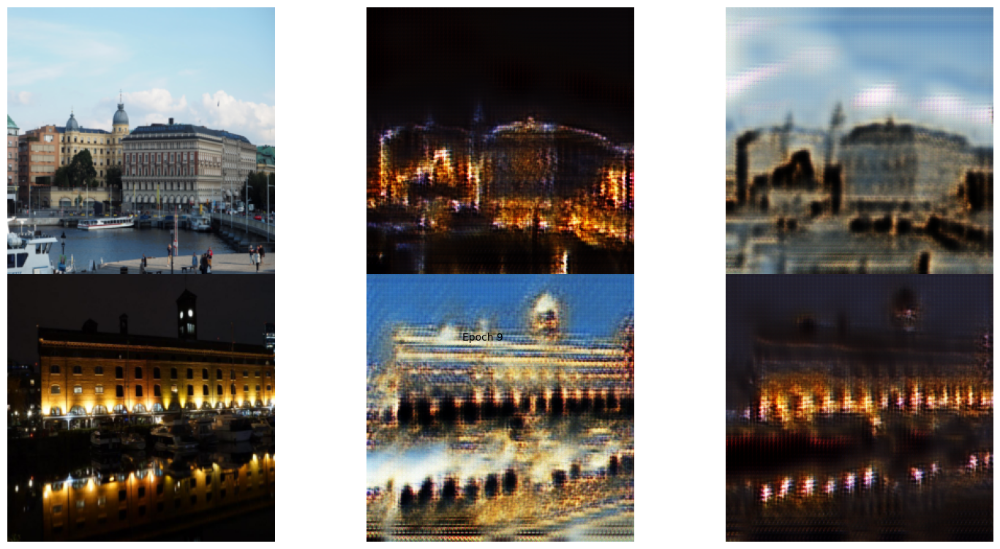

Epoch [10/20] (in 0364 seconds), Step [0200/0522], D_A_loss: 0.1545, D_B_loss: 0.0565, G_A_loss: 0.4142, G_B_loss: 0.3569


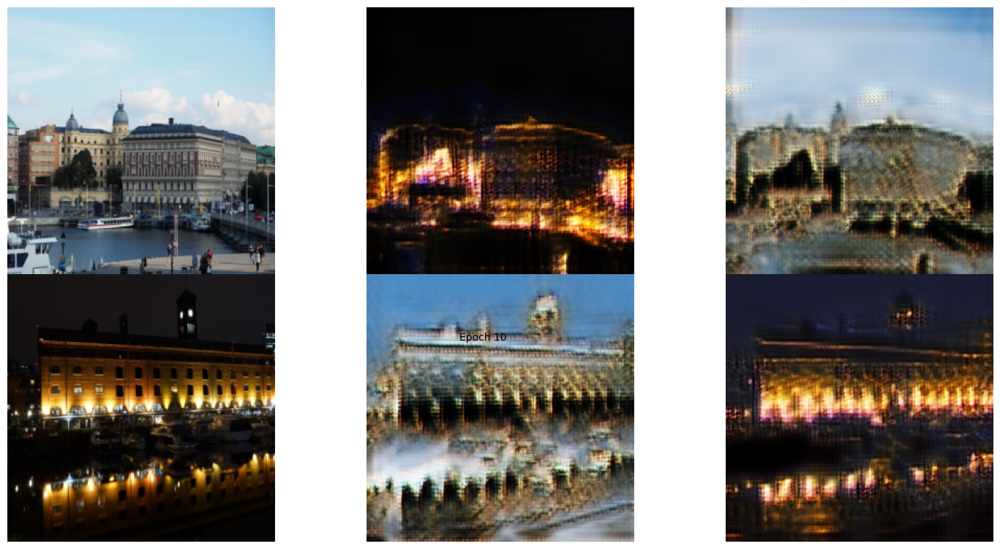

Epoch [11/20] (in 0362 seconds), Step [0200/0522], D_A_loss: 0.2852, D_B_loss: 0.2189, G_A_loss: 0.5555, G_B_loss: 0.1157


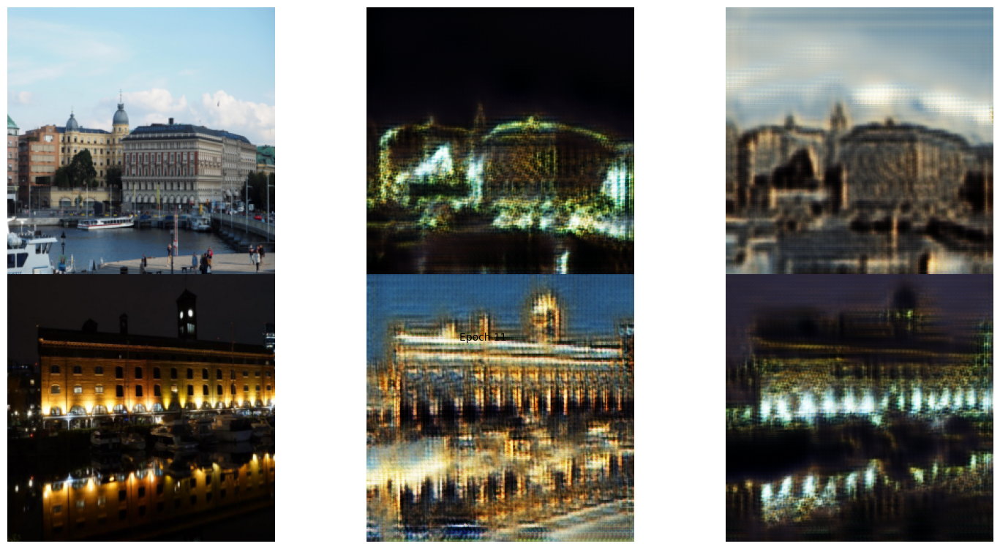

Epoch [12/20] (in 0363 seconds), Step [0200/0522], D_A_loss: 0.1320, D_B_loss: 0.1985, G_A_loss: 0.2012, G_B_loss: 0.3328


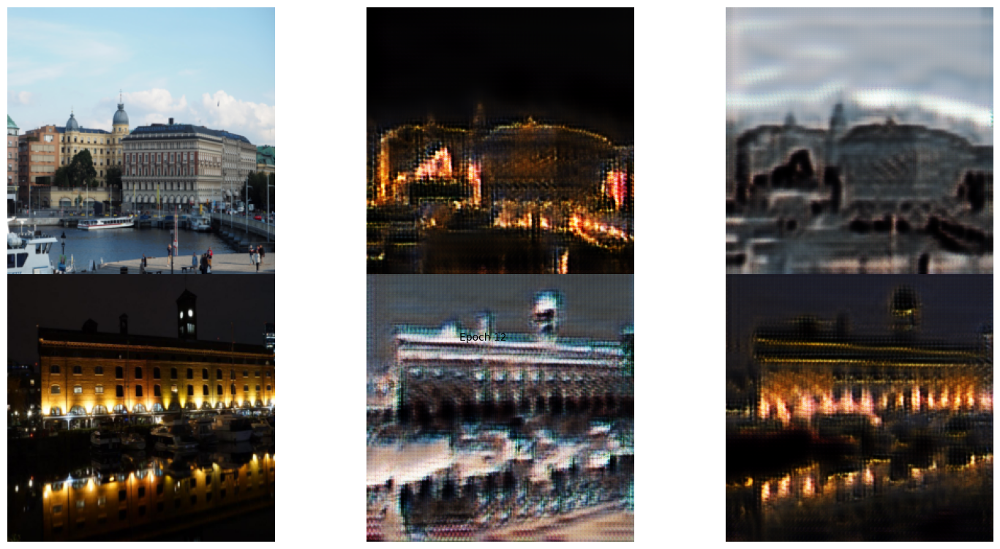

Epoch [13/20] (in 0360 seconds), Step [0200/0522], D_A_loss: 0.1508, D_B_loss: 0.3664, G_A_loss: 0.0442, G_B_loss: 0.4154


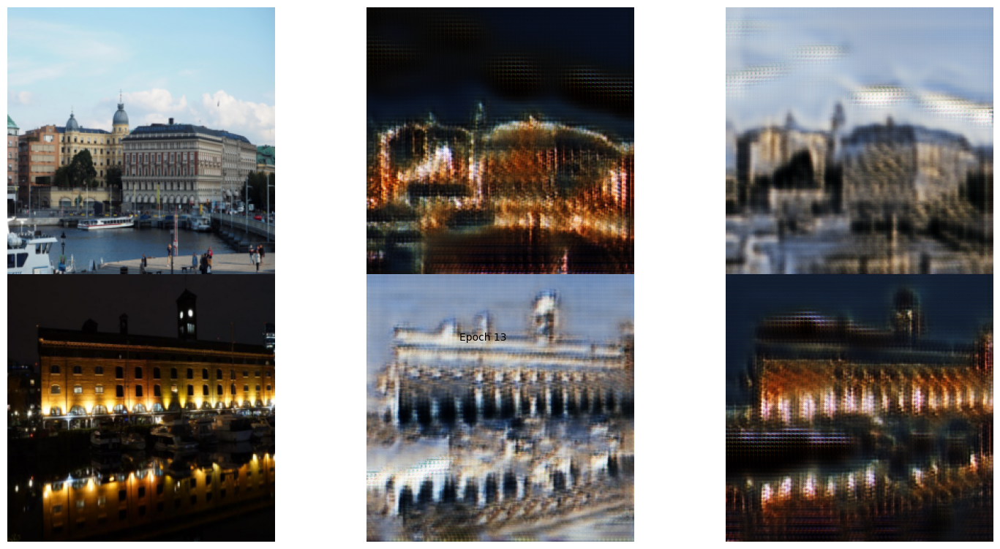

Epoch [14/20] (in 0362 seconds), Step [0200/0522], D_A_loss: 0.1129, D_B_loss: 0.1586, G_A_loss: 0.3264, G_B_loss: 0.6259


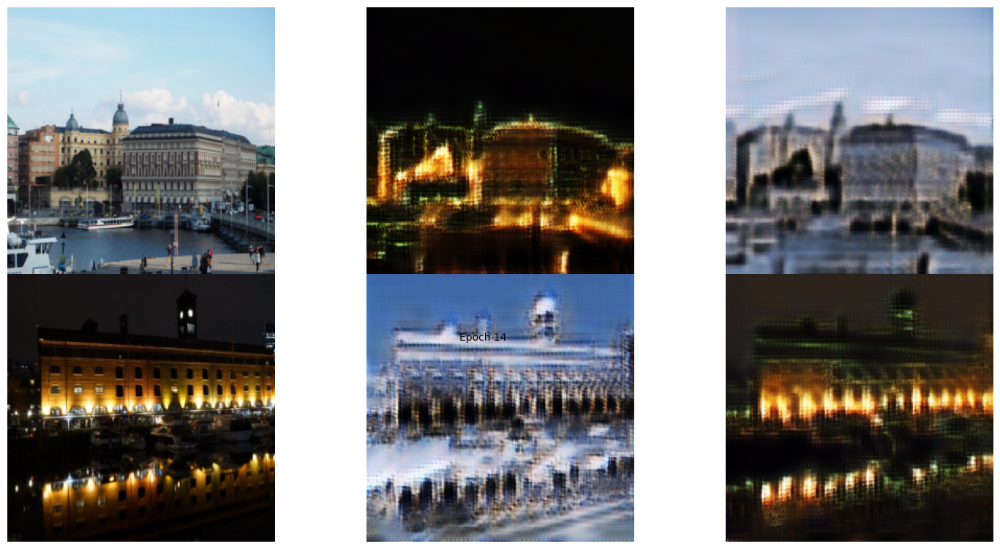

Epoch [15/20] (in 0360 seconds), Step [0200/0522], D_A_loss: 0.2435, D_B_loss: 0.1158, G_A_loss: 0.3646, G_B_loss: 0.1407


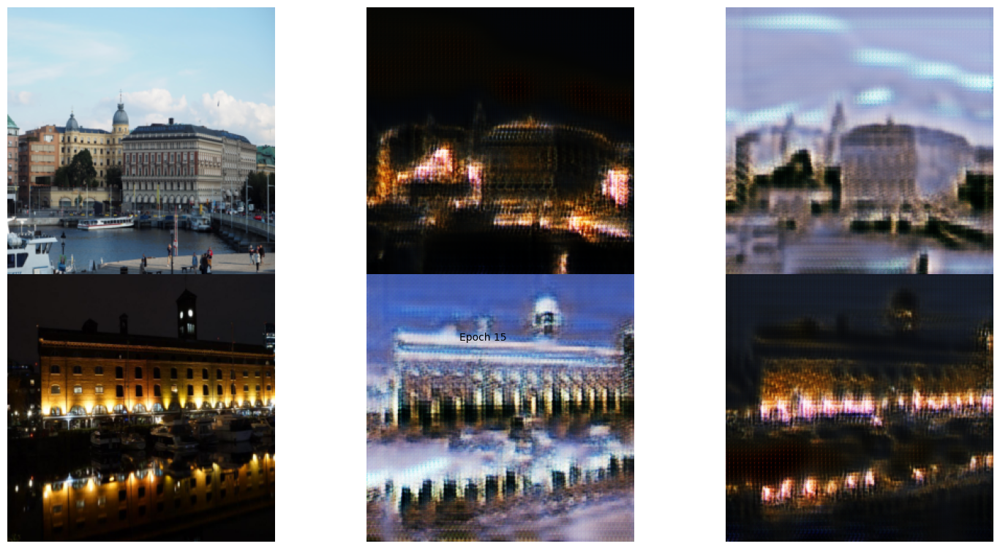

Epoch [16/20] (in 0360 seconds), Step [0200/0522], D_A_loss: 0.1254, D_B_loss: 0.0814, G_A_loss: 0.1243, G_B_loss: 0.3337


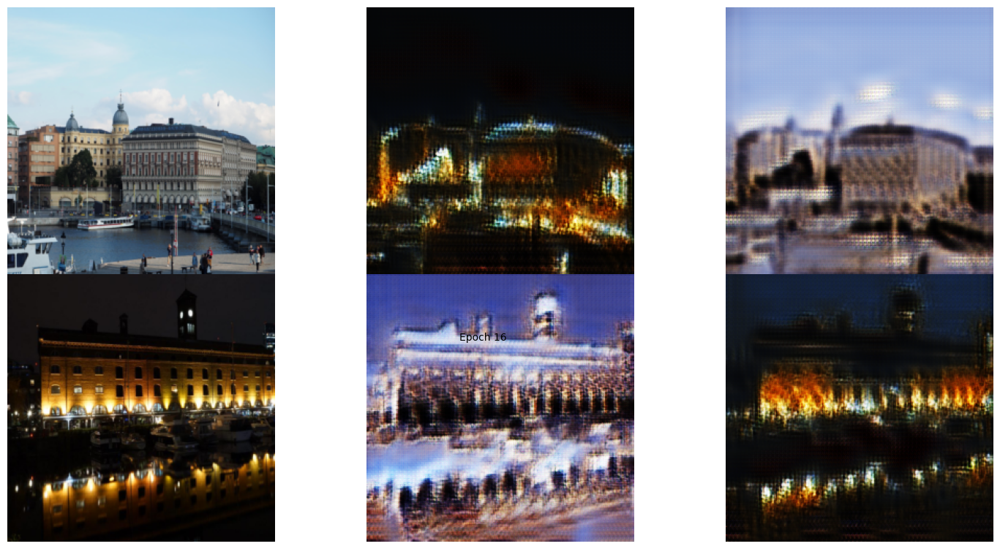

Epoch [17/20] (in 0362 seconds), Step [0200/0522], D_A_loss: 0.1557, D_B_loss: 0.1376, G_A_loss: 0.9782, G_B_loss: 0.6607


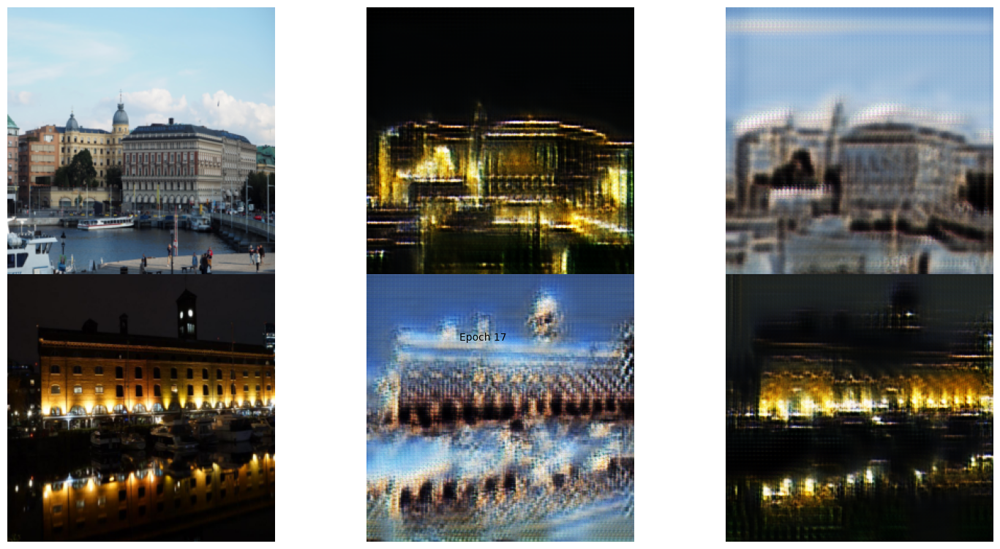

Epoch [18/20] (in 0362 seconds), Step [0200/0522], D_A_loss: 0.0681, D_B_loss: 0.0690, G_A_loss: 0.3442, G_B_loss: 0.0916


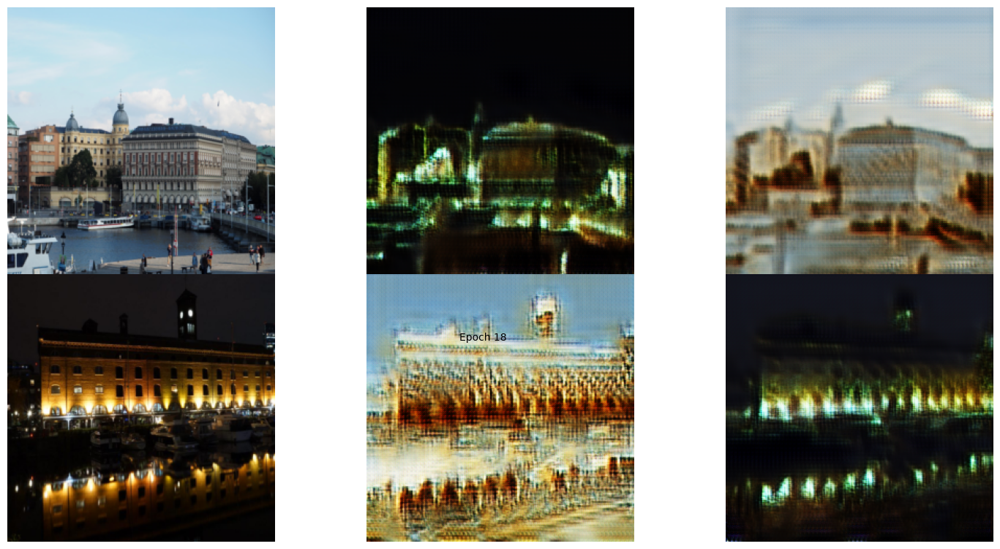

Epoch [19/20] (in 0364 seconds), Step [0200/0522], D_A_loss: 0.0493, D_B_loss: 0.0837, G_A_loss: 0.6652, G_B_loss: 0.7264


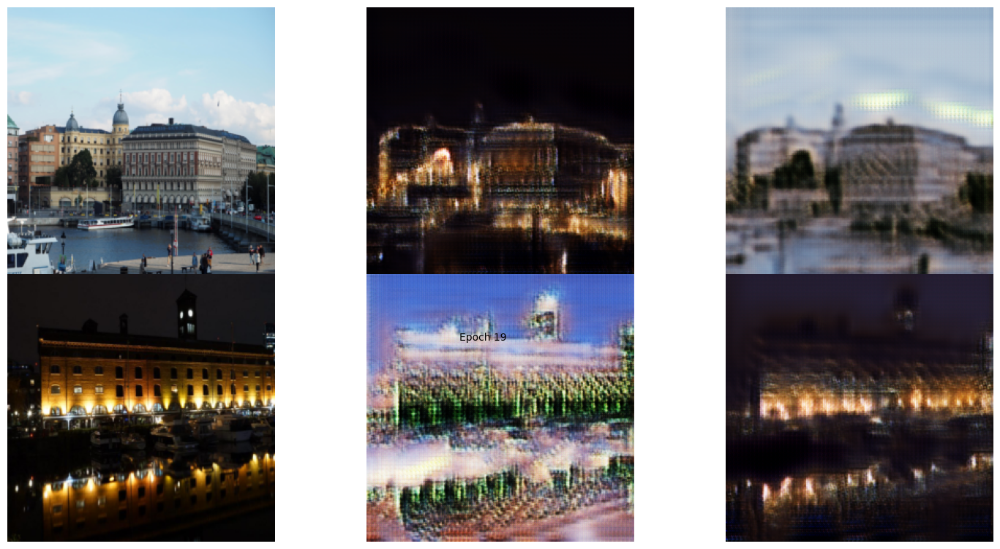

Epoch [20/20] (in 0359 seconds), Step [0200/0522], D_A_loss: 0.0343, D_B_loss: 0.0343, G_A_loss: 0.1791, G_B_loss: 0.2427


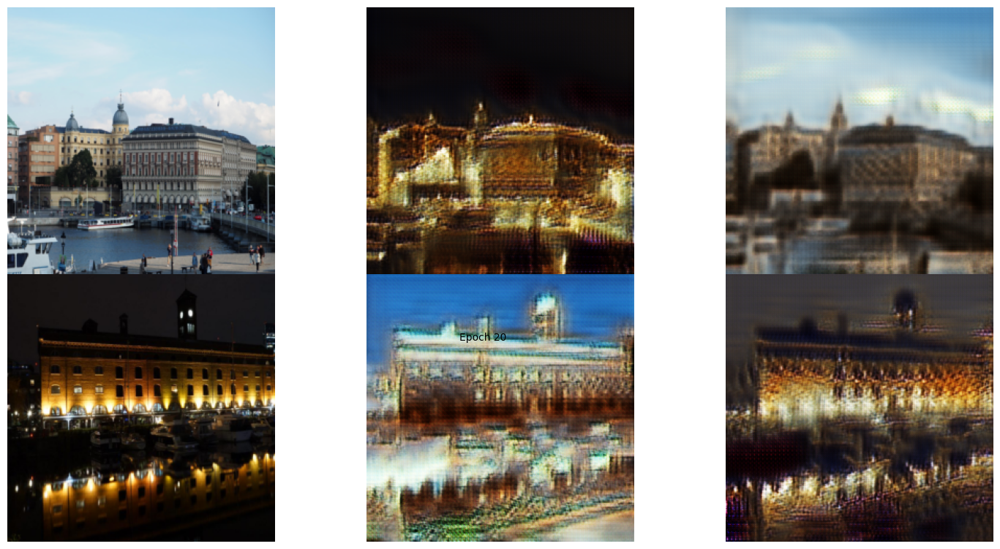

In [7]:
# Generated image pool
num_pool = 50
fake_A_pool = ImagePool(num_pool)
fake_B_pool = ImagePool(num_pool)

step = 0
for epoch in range(params['num_epochs']):
    t0 = time.time()
    D_A_losses = []
    D_B_losses = []
    G_A_losses = []
    G_B_losses = []
    cycle_A_losses = []
    cycle_B_losses = []
    
    # Learing rate decay 
    if(epoch + 1) > params['decay_epoch']:
        D_A_optimizer.param_groups[0]['lr'] -= params['lrD'] / (params['num_epochs'] - params['decay_epoch'])
        D_B_optimizer.param_groups[0]['lr'] -= params['lrD'] / (params['num_epochs'] - params['decay_epoch'])
        G_optimizer.param_groups[0]['lr'] -= params['lrG'] / (params['num_epochs'] - params['decay_epoch'])
        
    
    # training 
    for i, (real_A, real_B) in enumerate(zip(train_data_loader_A, train_data_loader_B)):
        # input image data
        real_A = real_A.to(device)
        real_B = real_B.to(device)
        
        # -------------------------- train generator G --------------------------
        # A --> B
        fake_B = G_A(real_A)
        D_B_fake_decision = D_B(fake_B)
        G_A_loss = MSE_Loss(D_B_fake_decision, Variable(torch.ones(D_B_fake_decision.size())
                                                        .cuda()
                                                       )
                                                    )
        
        # forward cycle loss
        recon_A = G_B(fake_B)
        cycle_A_loss = L1_Loss(recon_A, real_A) * params['lambdaA']
        
        # B --> A
        fake_A = G_B(real_B)
        D_A_fake_decision = D_A(fake_A)
        G_B_loss = MSE_Loss(D_A_fake_decision, Variable(torch.ones(D_A_fake_decision.size())
                                                        .cuda()
                                                    ))
        
        # backward cycle loss
        recon_B = G_A(fake_A)
        cycle_B_loss = L1_Loss(recon_B, real_B) * params['lambdaB']
        
        # Back propagation
        G_loss = G_A_loss + G_B_loss + cycle_A_loss + cycle_B_loss
        G_optimizer.zero_grad()
        G_loss.backward()
        G_optimizer.step()
        
        
        # -------------------------- train discriminator D_A --------------------------
        D_A_real_decision = D_A(real_A)
        D_A_real_loss = MSE_Loss(D_A_real_decision, Variable(torch.ones(D_A_real_decision.size())
                                                             .cuda()
                                                        ))
        
        fake_A = fake_A_pool.query(fake_A)
        
        D_A_fake_decision = D_A(fake_A)
        D_A_fake_loss = MSE_Loss(D_A_fake_decision, Variable(torch.zeros(D_A_fake_decision.size())
                                                             .cuda()
                                                            )
                                )
        
        # Back propagation
        D_A_loss = (D_A_real_loss + D_A_fake_loss) * 0.5
        D_A_optimizer.zero_grad()
        D_A_loss.backward()
        D_A_optimizer.step()
        
        # -------------------------- train discriminator D_B --------------------------
        D_B_real_decision = D_B(real_B)
        D_B_real_loss = MSE_Loss(D_B_real_decision, Variable(torch.ones(D_B_fake_decision.size())
                                                             .cuda()
                                                            ))
        
        fake_B = fake_B_pool.query(fake_B)
        
        D_B_fake_decision = D_B(fake_B)
        D_B_fake_loss = MSE_Loss(D_B_fake_decision, Variable(torch.zeros(D_B_fake_decision.size())
                                                             .cuda()
                                                            ))
        
        # Back propagation
        D_B_loss = (D_B_real_loss + D_B_fake_loss) * 0.5
        D_B_optimizer.zero_grad()
        D_B_loss.backward()
        D_B_optimizer.step()
        
        # ------------------------ Print -----------------------------
        # loss values
        D_A_losses.append(D_A_loss.item())
        D_B_losses.append(D_B_loss.item())
        G_A_losses.append(G_A_loss.item())
        G_B_losses.append(G_B_loss.item())
        cycle_A_losses.append(cycle_A_loss.item())
        cycle_B_losses.append(cycle_B_loss.item())

        if i%200 == 199:
            t = time.time() - t0
            print(f'Epoch [%d/%d] (in 03%d seconds), Step [%04d/%04d], D_A_loss: %.4f, D_B_loss: %.4f, G_A_loss: %.4f, G_B_loss: %.4f'
                  % (epoch+1, params['num_epochs'], int(t), i+1, len(train_data_loader_A), D_A_loss.item(), D_B_loss.item(), G_A_loss.item(), G_B_loss.item()))
            
        step += 1
        
    D_A_avg_loss = torch.mean(torch.FloatTensor(D_A_losses))
    D_B_avg_loss = torch.mean(torch.FloatTensor(D_B_losses))
    G_A_avg_loss = torch.mean(torch.FloatTensor(G_A_losses))
    G_B_avg_loss = torch.mean(torch.FloatTensor(G_B_losses))
    cycle_A_avg_loss = torch.mean(torch.FloatTensor(cycle_A_losses))
    cycle_B_avg_loss = torch.mean(torch.FloatTensor(cycle_B_losses))

    # avg loss values for plot
    D_A_avg_losses.append(D_A_avg_loss.item())
    D_B_avg_losses.append(D_B_avg_loss.item())
    G_A_avg_losses.append(G_A_avg_loss.item())
    G_B_avg_losses.append(G_B_avg_loss.item())
    cycle_A_avg_losses.append(cycle_A_avg_loss.item())
    cycle_B_avg_losses.append(cycle_B_avg_loss.item())
    
    # Show result for test image
    test_real_A = test_real_A_data.cuda()
    test_fake_B = G_A(test_real_A)
    test_recon_A = G_B(test_fake_B)

    test_real_B = test_real_B_data.cuda()
    test_fake_A = G_B(test_real_B)
    test_recon_B = G_A(test_fake_A)

    plot_train_result([test_real_A, test_real_B], 
                      [test_fake_B, test_fake_A], 
                      [test_recon_A, test_recon_B],
                        epoch, save=True)

all_losses = pd.DataFrame()
all_losses['D_A_avg_losses'] = D_A_avg_losses
all_losses['D_B_avg_losses'] = D_B_avg_losses
all_losses['G_A_avg_losses'] = G_A_avg_losses
all_losses['G_B_avg_losses'] = G_B_avg_losses
all_losses['cycle_A_avg_losses'] = cycle_A_avg_losses
all_losses['cycle_B_avg_losses'] = cycle_B_avg_losses

all_losses.to_csv('avg_losses',index=False)

### Convert new-input

In [8]:
torch.save(G_A.state_dict(), 'torch_cyclegan_A')
torch.save(G_B.state_dict(), 'torch_cyclegan_B')

In [9]:
G_A_new = Generator(3, params['ngf'], 3, params['num_resnet'])
G_B_new = Generator(3, params['ngf'], 3, params['num_resnet'])

 # Convert to 4d tensor (BxNxHxW)
test_real_A_data = train_data_A.__getitem__(11).unsqueeze(0)
test_real_B_data = train_data_B.__getitem__(19).unsqueeze(0)

test_real_A = test_real_A_data
test_real_B = test_real_B_data
test_fake_A = G_B_new(test_real_B)
test_fake_B = G_A_new(test_real_A)

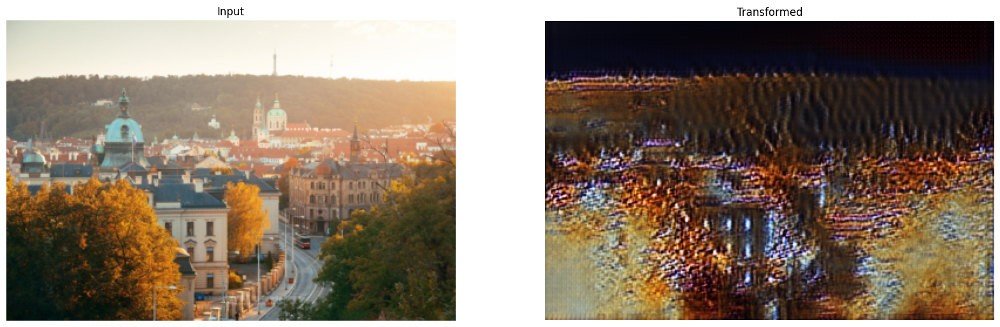

In [16]:
G_A_new.load_state_dict(torch.load('torch_cyclegan_A'))
G_B_new.load_state_dict(torch.load('torch_cyclegan_B'))

def test_view(k=-1):

    real_img = list(test_data_loader_A)[k][0]
    fake_B = G_A_new(real_img)
    recon_A = G_B_new(fake_B)
    img_transform = to_np(fake_B)
    imgs = [real_img, img_transform, recon_A]
    _, ax = plt.subplots(1, 2, figsize=(20, 7))

    real_img = to_np(real_img).squeeze()
    real_img = (((real_img - real_img.min()) * 255) / (real_img.max() - real_img.min())).transpose(1, 2, 0).astype(np.uint8)
    ax[0].imshow(real_img)
    ax[0].set_axis_off()
    ax[0].set_title("Input")

    img_transform = img_transform.squeeze()
    img_transform = (((img_transform - img_transform.min()) * 255) / (img_transform.max() - img_transform.min())).transpose(1, 2, 0).astype(np.uint32)
    ax[1].imshow(img_transform)
    ax[1].set_axis_off()
    ax[1].set_title("Transformed")
    
    plt.show()
    
test_view()

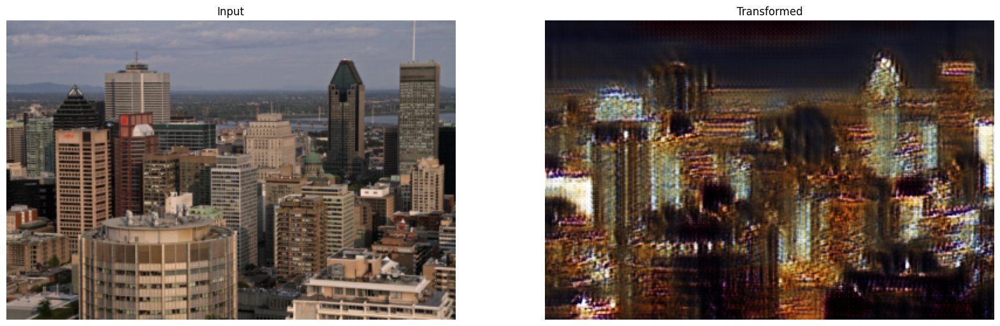

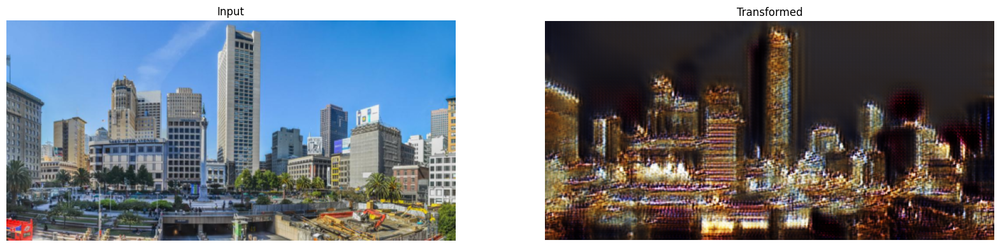

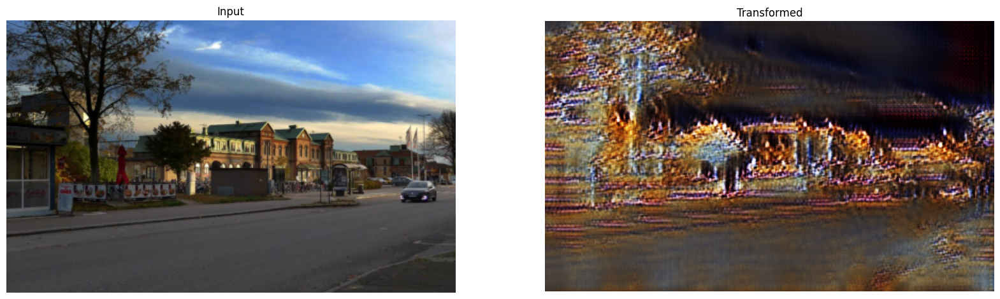

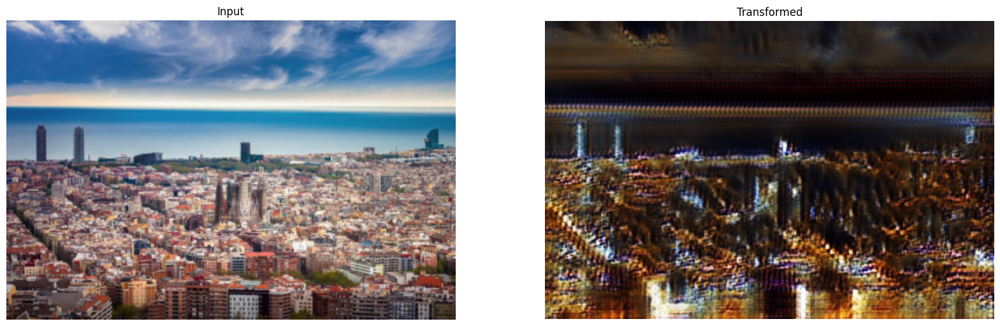

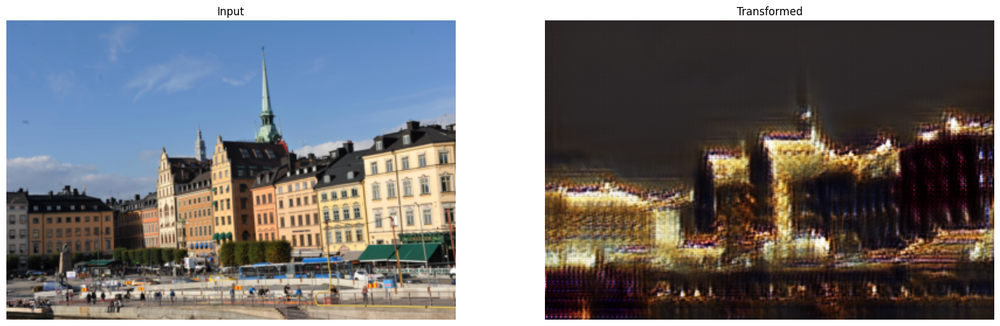

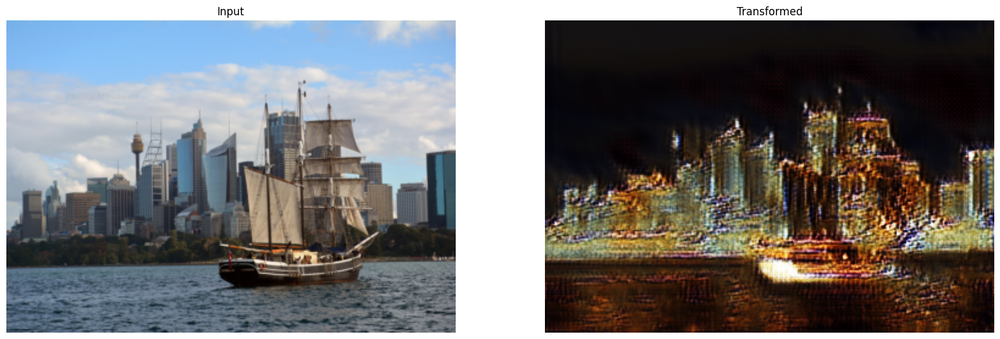

In [17]:
for k in range(6):
    test_view(k)